<a href="https://colab.research.google.com/github/Code-Pulkit/EDA_US_DataSets/blob/main/EDA_US_Accidents.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Data is for 49 states only not 50 states. 


Dataset from Kaggle - US Accidents : 
   

In [1]:
pip install opendatasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import opendatasets as od
download_url = 'https://www.kaggle.com/datasets/sobhanmoosavi/us-accidents'
od.download(download_url)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: pulkitji
Your Kaggle Key: ··········


100%|██████████| 269M/269M [00:01<00:00, 149MB/s]


#### Data Prep and Cleaning 
 1. Look at file 
 2. Some Information about data and columns 
 3. Fix missing or Incorrect Values

In [3]:
import pandas as pd

In [4]:

data = './us-accidents/US_Accidents_Dec21_updated.csv'
df = pd.read_csv(data)

In [5]:
df.shape

(2845342, 47)

In [6]:
df.columns

Index(['ID', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng',
       'End_Lat', 'End_Lng', 'Distance(mi)', 'Description', 'Number', 'Street',
       'Side', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2845342 entries, 0 to 2845341
Data columns (total 47 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   ID                     object 
 1   Severity               int64  
 2   Start_Time             object 
 3   End_Time               object 
 4   Start_Lat              float64
 5   Start_Lng              float64
 6   End_Lat                float64
 7   End_Lng                float64
 8   Distance(mi)           float64
 9   Description            object 
 10  Number                 float64
 11  Street                 object 
 12  Side                   object 
 13  City                   object 
 14  County                 object 
 15  State                  object 
 16  Zipcode                object 
 17  Country                object 
 18  Timezone               object 
 19  Airport_Code           object 
 20  Weather_Timestamp      object 
 21  Temperature(F)         float64
 22  Wind_Chill(F)     

In [8]:
df.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Number,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,2.845342e+06,2.845342e+06,2.845342e+06,2.845342e+06,2.845342e+06,2.845342e+06,1.101431e+06,2.776068e+06,2.375699e+06,2.772250e+06,2.786142e+06,2.774796e+06,2.687398e+06,2.295884e+06
mean,2.137572e+00,3.624520e+01,-9.711463e+01,3.624532e+01,-9.711439e+01,7.026779e-01,8.089408e+03,6.179356e+01,5.965823e+01,6.436545e+01,2.947234e+01,9.099391e+00,7.395044e+00,7.016940e-03
std,4.787216e-01,5.363797e+00,1.831782e+01,5.363873e+00,1.831763e+01,1.560361e+00,1.836009e+04,1.862263e+01,2.116097e+01,2.287457e+01,1.045286e+00,2.717546e+00,5.527454e+00,9.348831e-02
min,1.000000e+00,2.456603e+01,-1.245481e+02,2.456601e+01,-1.245457e+02,0.000000e+00,0.000000e+00,-8.900000e+01,-8.900000e+01,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,3.344517e+01,-1.180331e+02,3.344628e+01,-1.180333e+02,5.200000e-02,1.270000e+03,5.000000e+01,4.600000e+01,4.800000e+01,2.931000e+01,1.000000e+01,3.500000e+00,0.000000e+00
50%,2.000000e+00,3.609861e+01,-9.241808e+01,3.609799e+01,-9.241772e+01,2.440000e-01,4.007000e+03,6.400000e+01,6.300000e+01,6.700000e+01,2.982000e+01,1.000000e+01,7.000000e+00,0.000000e+00
75%,2.000000e+00,4.016024e+01,-8.037243e+01,4.016105e+01,-8.037338e+01,7.640000e-01,9.567000e+03,7.600000e+01,7.600000e+01,8.300000e+01,3.001000e+01,1.000000e+01,1.000000e+01,0.000000e+00
max,4.000000e+00,4.900058e+01,-6.711317e+01,4.907500e+01,-6.710924e+01,1.551860e+02,9.999997e+06,1.960000e+02,1.960000e+02,1.000000e+02,5.890000e+01,1.400000e+02,1.087000e+03,2.400000e+01


Ask and answer Questions - 
  1. Are there more accidents in hot or cold areas ?
  2. Which States have highest accidents?
  3. Accidents / Per Capita
  4. 


In [9]:
numerics = ['int16', 'int32', 'int64' , 'float16' , 'float32' ,'float64']
numeric_df = df.select_dtypes(include=numerics)

In [10]:
numeric_df

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Number,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
0,3,40.108910,-83.092860,40.112060,-83.031870,3.230,NaN,42.1,36.1,58.0,29.76,10.0,10.4,0.00
1,2,39.865420,-84.062800,39.865010,-84.048730,0.747,NaN,36.9,NaN,91.0,29.68,10.0,NaN,0.02
2,2,39.102660,-84.524680,39.102090,-84.523960,0.055,NaN,36.0,NaN,97.0,29.70,10.0,NaN,0.02
3,2,41.062130,-81.537840,41.062170,-81.535470,0.123,NaN,39.0,NaN,55.0,29.65,10.0,NaN,NaN
4,3,39.172393,-84.492792,39.170476,-84.501798,0.500,NaN,37.0,29.8,93.0,29.69,10.0,10.4,0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2845337,2,34.002480,-117.379360,33.998880,-117.370940,0.543,NaN,86.0,86.0,40.0,28.92,10.0,13.0,0.00
2845338,2,32.766960,-117.148060,32.765550,-117.153630,0.338,NaN,70.0,70.0,73.0,29.39,10.0,6.0,0.00
2845339,2,33.775450,-117.847790,33.777400,-117.857270,0.561,NaN,73.0,73.0,64.0,29.74,10.0,10.0,0.00
2845340,2,33.992460,-118.403020,33.983110,-118.395650,0.772,NaN,71.0,71.0,81.0,29.62,10.0,8.0,0.00


In [11]:
missing_percent = df.isna().sum().sort_values(ascending = False)/len(df)*100

In [12]:
missing_percent = missing_percent[missing_percent != 0]

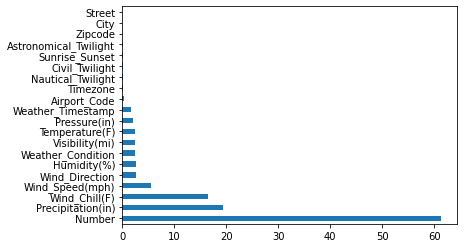

In [13]:
missing_percent.plot(kind = 'barh')

More than 50% of the data is unavailable So there might be no use of Number

In [14]:
df.drop(['Number'] ,axis=1 , inplace = True)

In [15]:
df.columns

Index(['ID', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng',
       'End_Lat', 'End_Lng', 'Distance(mi)', 'Description', 'Street', 'Side',
       'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

Columns To Examine
  - Info about Datasset 
    https://smoosavi.org/datasets/us_accidents


In [16]:
columns = ['Start_Time' , 'End_Time' , 'Start_Lat' , 'City' , 'Country']

In [17]:
cities = df.City.unique()
len(cities)

11682

In [18]:
cities_by_accident = df.City.value_counts()

In [19]:
cities_by_accident[:10]

Miami          106966
Los Angeles     68956
Orlando         54691
Dallas          41979
Houston         39448
Charlotte       33152
Sacramento      32559
San Diego       26627
Raleigh         22840
Minneapolis     22768
Name: City, dtype: int64

Why Doesn't **New York show up in the list** as the city is in the top population?




In [20]:
'New York' in cities_by_accident

True

In [21]:
State_List = df.State.unique()

In [22]:
'NY' in State_List

True

In [23]:
cities_by_accident['New York']

7068

In [24]:
import plotly.express as px
import seaborn as sns

In [25]:
px.bar(cities_by_accident[:10],  orientation='h')

In [ ]:
px.histogram(cities_by_accident)

4. Among the top 100 accidents , how many of which state ?  Grouping the 100 most accidental states ?


In [26]:
df.shape

(2845342, 46)

In [27]:
high_accident_city = cities_by_accident[cities_by_accident >= 2000]
low_accident_city = cities_by_accident[cities_by_accident < 2000]
len(low_accident_city)

11463

In [28]:
import seaborn as sns 

In [29]:
px.histogram(high_accident_city)

In [30]:
px.histogram(low_accident_city , log_y = True)


In [31]:
cities_by_accident[cities_by_accident == 1]

Carney                          1
Waverly Hall                    1
Center Sandwich                 1
Glen Flora                      1
Sulphur Springs                 1
                               ..
Ridgedale                       1
Sekiu                           1
Wooldridge                      1
Bullock                         1
American Fork-Pleasant Grove    1
Name: City, Length: 1110, dtype: int64

In [32]:
cities_by_accident[cities_by_accident == 2]

Sullivans Island    2
Brilliant           2
Duson               2
Binford             2
Parrott             2
                   ..
Saint Marks         2
Anza                2
Driggs              2
Summertown          2
Enville             2
Name: City, Length: 819, dtype: int64

Very Peculiar that nearly 1K had only 1 accident and nearly 4K cities had less than 10 accidents in a span of such a long duration.


In [33]:
cities_by_accident[cities_by_accident <= 10]

Elba                            10
North Arlington                 10
Delco                           10
Bloomsbury                      10
Doniphan                        10
                                ..
Ridgedale                        1
Sekiu                            1
Wooldridge                       1
Bullock                          1
American Fork-Pleasant Grove     1
Name: City, Length: 4628, dtype: int64

**Start Time Analysis**

In [34]:
df.Start_Time.head()

0    2016-02-08 00:37:08
1    2016-02-08 05:56:20
2    2016-02-08 06:15:39
3    2016-02-08 06:51:45
4    2016-02-08 07:53:43
Name: Start_Time, dtype: object

In [ ]:
df.Start_Time = pd.to_datetime(df.Start_Time)

In [ ]:
df.Start_Time[0]

Timestamp('2016-02-08 00:37:08')

Some Questions that could be answered.
  1. What time of Day ?
  2. Which Day of Month?
  3. Trend Over Year?
  4. Which Month Of Year ?

In [ ]:
fig = px.histogram(df.Start_Time.dt.hour)
fig.update_layout(bargap=0.2)
fig.show()

- High Accidents - 12pm to 6pm 

In [ ]:
fig = px.histogram(df.Start_Time.dt.hour , histnorm = 'percent')
fig.update_layout(bargap=0.2)
fig.show()

Get the data for Total Traffic and compare accident Rate?


In [ ]:
fig = px.histogram(df.Start_Time.dt.dayofweek , histnorm = 'percent')
fig.update_layout(bargap=0.2)
fig.show()

Is the Distribution same as Weekday and Weekend (Hour to Hour) ?

In [ ]:
Sunday_data = df[df.Start_Time.dt.dayofweek == 6]
Monday_data = df[df.Start_Time.dt.dayofweek == 0]

In [ ]:
fig = px.histogram(Sunday_data.Start_Time.dt.hour , histnorm = 'percent')
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(Monday_data.Start_Time.dt.hour , histnorm = 'percent')
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(df.Start_Time.dt.month , histnorm = 'percent')
fig.update_layout(bargap=0.2)
fig.show()

How can the monthwise trend be explained ?

In [ ]:
df_2019 = df[df.Start_Time.dt.year == 2019]

In [ ]:
fig = px.histogram(df_2019.Start_Time.dt.month , histnorm = 'percent')
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
df_2016 = df[df.Start_Time.dt.year == 2016]
fig = px.histogram(df_2016.Start_Time.dt.month , histnorm = 'percent')
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
df_2017 = df[df.Start_Time.dt.year == 2017]
fig = px.histogram(df_2017.Start_Time.dt.month , histnorm = 'percent')
fig.update_layout(bargap=0.2)
fig.show()

There might be issue with Source as Bing or MapQuest

In [ ]:
'Source' in df.columns

False